In [1]:
import pandas as pd
from transformers import AutoTokenizer, AutoModel, pipeline
import torch
import pickle
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
import numpy as np
from scipy.spatial.distance import cosine
import matplotlib.pyplot as plt

2023-10-08 19:07:35.730925: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-10-08 19:07:53.441731: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory
2023-10-08 19:07:53.442405: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory
2023-10-08 19:07:53.442470: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Cannot dlopen some TensorRT libraries. If you would like to use Nv

In [4]:
data_path = '/home/maaz-lfd/Maaz/Thesis/Thesis/dataset/clinical_trials/round_5/round5_abstract_pmc.csv'

In [5]:
df = pd.read_csv(data_path)
df

,pmcid,abstract
0,PMC137267,Recent evidence suggests that critically ill p...
1,PMC137274,The 21st International Symposium on Intensive ...
2,PMC1475929,The anticancer potential of catechins derived ...
3,PMC1481583,BACKGROUND: Patients with chronic obstructive ...
4,PMC1525174,BACKGROUND: Because smallpox (variola major) m...
...,...,...
7817,PMC4183573,Viruses utilize host factors for their efficie...
7818,PMC7347494,It is clear that existing cardiovascular disea...
7819,PMC4896990,Acute and chronic inflammatory responses in th...
7820,PMC7261085,"COVID-19, a respiratory disease caused by seve..."


In [6]:
tokenizer = AutoTokenizer.from_pretrained("microsoft/BiomedNLP-PubMedELECTRA-large-uncased-abstract")
model = AutoModel.from_pretrained("microsoft/BiomedNLP-PubMedELECTRA-large-uncased-abstract")
# model = pipeline(model= "microsoft/BiomedNLP-PubMedELECTRA-large-uncased-abstract")

Some weights of the model checkpoint at microsoft/BiomedNLP-PubMedELECTRA-large-uncased-abstract were not used when initializing BertModel: ['cls.predictions.transform.dense.weight', 'cls.predictions.decoder.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.bias', 'cls.predictions.decoder.weight', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.LayerNorm.bias', 'cls.seq_relationship.weight', 'cls.seq_relationship.bias']
- This IS expected if you are initializing BertModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


In [7]:
model.config

BertConfig {
  "_name_or_path": "microsoft/BiomedNLP-PubMedELECTRA-large-uncased-abstract",
  "architectures": [
    "BertModel"
  ],
  "attention_probs_dropout_prob": 0.1,
  "bos_token_id": 0,
  "classifier_dropout": null,
  "eos_token_ids": 0,
  "hidden_act": "gelu",
  "hidden_dropout_prob": 0.1,
  "hidden_size": 1024,
  "initializer_range": 0.02,
  "intermediate_size": 4096,
  "layer_norm_eps": 1e-12,
  "max_position_embeddings": 512,
  "model_type": "bert",
  "num_attention_heads": 16,
  "num_hidden_layers": 24,
  "output_past": true,
  "pad_token_id": 0,
  "position_embedding_type": "absolute",
  "transformers_version": "4.29.2",
  "type_vocab_size": 2,
  "use_cache": true,
  "vocab_size": 30522
}

In [7]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

BertModel(
  (embeddings): BertEmbeddings(
    (word_embeddings): Embedding(30522, 1024, padding_idx=0)
    (position_embeddings): Embedding(512, 1024)
    (token_type_embeddings): Embedding(2, 1024)
    (LayerNorm): LayerNorm((1024,), eps=1e-12, elementwise_affine=True)
    (dropout): Dropout(p=0.1, inplace=False)
  )
  (encoder): BertEncoder(
    (layer): ModuleList(
      (0-23): 24 x BertLayer(
        (attention): BertAttention(
          (self): BertSelfAttention(
            (query): Linear(in_features=1024, out_features=1024, bias=True)
            (key): Linear(in_features=1024, out_features=1024, bias=True)
            (value): Linear(in_features=1024, out_features=1024, bias=True)
            (dropout): Dropout(p=0.1, inplace=False)
          )
          (output): BertSelfOutput(
            (dense): Linear(in_features=1024, out_features=1024, bias=True)
            (LayerNorm): LayerNorm((1024,), eps=1e-12, elementwise_affine=True)
            (dropout): Dropout(p=0.1, inpl

In [15]:
device

device(type='cuda')

**Testing the embedding and their similarities** <br>
Query is from the research paper test dataset and selected abstract are the results based on tf-idf of title

In [25]:
slice_df = df[df['pmcid'].isin(['PMC7087728','PMC7121664','PMC7123827','PMC5353349','PMC6689073','PMC7185644'])]
slice_df

,pmcid,abstract
1399,PMC7121664,Since vaccination was documented by Edward Jen...
1618,PMC7123827,Since the introduction of smallpox vaccination...
2734,PMC7087728,Acute cough is among the most common symptoms ...
4075,PMC5353349,INTRODUCTION: Acute respiratory infections (AR...
5502,PMC6689073,Background Acute bronchiolitis is common in yo...
6902,PMC7185644,"Abstract Xenotransplantation using pig cells, ..."


In [9]:
query_token = tokenizer(df['abstract'][0], padding='max_length', truncation=True, max_length=512, return_tensors="pt")

with torch.no_grad():
        query_token = {key: val.to(device) for key, val in query_token.items()}
        outputs = model(**query_token)
        query_embedding = outputs.last_hidden_state.mean(dim=1).cpu().numpy().reshape(1024)
query_embedding

array([-0.4851049 ,  0.5274148 , -0.24928541, ..., -0.70523787,
        0.7417286 ,  0.4911654 ], dtype=float32)

In [11]:
saved_emb = pickle.loads(open('/home/maaz-lfd/Maaz/Thesis/Thesis/dataset/clinical_trials/round_5/abstract_embedding','rb').read())
saved_emb[-1]

array([-0.28625652, -0.52454895,  0.41834497, ..., -0.1109145 ,
        0.51317084, -0.08559568], dtype=float32)

In [33]:
query_token_2 = tokenizer("Amantadine and rimantadine for inﬂuenza A in children and the elderly", padding='max_length', truncation=True, max_length=512, return_tensors="pt")
with torch.no_grad():
        outputs = model(**query_token_2)
        query_embedding_2 = outputs.last_hidden_state.mean(dim=1).numpy().reshape(1024)
query_embedding_2

array([-2.0474072 ,  1.4683788 ,  0.13362572, ..., -0.9683944 ,
       -0.13560358,  0.7227959 ], dtype=float32)

In [34]:
cosine(query_embedding,query_embedding_2)

0.012497782707214355

In [38]:
query_token

['am',
 '##ant',
 '##adine',
 'and',
 'rim',
 '##ant',
 '##adine',
 'for',
 'in',
 '##ﬂ',
 '##ue',
 '##n',
 '##z',
 '##a',
 'a',
 'in',
 'children',
 'and',
 'the',
 'elderly',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[PAD]',
 '[

In [27]:
query_embedding.shape

(1024,)

In [28]:
for index, row in slice_df.iterrows():
    abstract = row['abstract']
    abstract_token = tokenizer(abstract, padding='max_length', truncation=True, max_length=512, return_tensors="pt")
    with torch.no_grad():
            outputs = model(**abstract_token)
            abstract_embedding = outputs.last_hidden_state.mean(dim=1).numpy().reshape(1024)
    print(f"{row['pmcid']}\t{1-cosine(query_embedding,abstract_embedding)}")

PMC7121664	0.9366933703422546
PMC7123827	0.8801418542861938
PMC7087728	0.9091562032699585
PMC5353349	0.2913990914821625
PMC6689073	0.7789255380630493
PMC7185644	0.843865692615509


In [ ]:
df['abstract'].isna().any()

False

In [6]:
failed_ids = []
abstract_embeddings = []

#### Testing
Testing the pipeline on chunk

In [19]:
# df_chunk = df.iloc[:100]

# Split the DataFrame into batches of 100 samples
batch_size = 10
batches = [df[i:i+batch_size] for i in range(0, len(df), batch_size)]

In [21]:
len(batches)

783

In [20]:
len(batches[-1])

2

In [23]:
model.eval()
first_batch = True
count = 1
for batch in batches:
    print("Batch ",count)
    abs_tokens = tokenizer(batch['abstract'].tolist(), padding='max_length', truncation=True, max_length=512, return_tensors="pt")
    abs_tokens = {key: val.to(device) for key, val in abs_tokens.items()}
    # abs_tokens = tokenizer(df['abstract'].tolist(), padding='max_length', truncation=True, max_length=512, return_tensors="pt")
    with torch.no_grad():
        outputs = model(**abs_tokens)
        embedding = outputs.last_hidden_state.mean(dim=1).cpu().numpy()

        # if first_batch == True:
        #         with open('/home/maaz-lfd/Maaz/Thesis/Thesis/dataset/clinical_trials/round_5/abstract_embedding','wb') as f:
        #                 pickle.dump(embedding,f)
        #         first_batch = False
        # else:
        #         saved_emb = pickle.loads(open('/home/maaz-lfd/Maaz/Thesis/Thesis/dataset/clinical_trials/round_5/abstract_embedding','rb').read())
        #         concat_emb = np.concatenate((embedding,saved_emb))
        #         print("shape after concatination ",concat_emb.shape)
        #         with open('/home/maaz-lfd/Maaz/Thesis/Thesis/dataset/clinical_trials/round_5/abstract_embedding','wb') as f:
        #                 pickle.dump(concat_emb,f)
    count +=1

Batch  1
Batch  2
Batch  3
Batch  4
Batch  5
Batch  6
Batch  7
Batch  8
Batch  9
Batch  10
Batch  11
Batch  12
Batch  13
Batch  14
Batch  15
Batch  16
Batch  17
Batch  18


KeyboardInterrupt: 

: 

In [19]:
concat_emb.shape

(7822, 1024)

In [2]:
saved_emb = pickle.loads(open('/home/maaz-lfd/Maaz/Thesis/Thesis/dataset/clinical_trials/round_5/abstract_embedding_clinical_bert','rb').read())
saved_emb[-1]

array([-1.72587365e-01, -2.26292789e-01,  4.03666943e-01, -1.36309028e-01,
       -1.66972518e-01, -1.92493945e-01, -2.39276335e-01,  3.19412261e-01,
        1.11698031e-01,  1.30234271e-01, -2.40095869e-01,  1.28563821e-01,
        5.25433496e-02,  4.86131430e-01,  3.02682847e-01, -2.14941889e-01,
        2.73413718e-01, -3.05431724e-01, -2.13768572e-01,  3.43769968e-01,
       -1.01826862e-01,  1.20562688e-01,  2.71944106e-02,  5.56338243e-02,
        1.00500196e-01,  1.81955516e-01, -5.19260019e-02, -5.89500181e-02,
       -4.66421127e-01, -2.12038279e-01,  1.51574045e-01,  2.69728541e-01,
       -2.45609850e-01,  1.55608021e-02, -1.29880428e-01,  2.06881855e-03,
        2.20511220e-02, -2.70425342e-04, -2.36739088e-02,  1.01560943e-01,
        1.46856457e-01, -7.21183047e-03,  2.78576553e-01, -1.01099581e-01,
       -1.61987528e-01, -1.14524491e-01, -2.03980636e-02,  9.08530056e-02,
       -1.78491056e-01,  3.00004721e-01,  6.95254281e-02, -1.49939075e-01,
        3.68169516e-01, -

In [3]:
tsne = TSNE(n_iter=5000, metric='cosine')
reduced_embeddings_tsne = tsne.fit_transform(saved_emb)

In [4]:
# Assuming 'embeddings' is a matrix where each row corresponds to an abstract's embedding
pca = PCA(n_components=2)  # You can adjust the number of components as needed
reduced_embeddings_pca = pca.fit_transform(saved_emb)

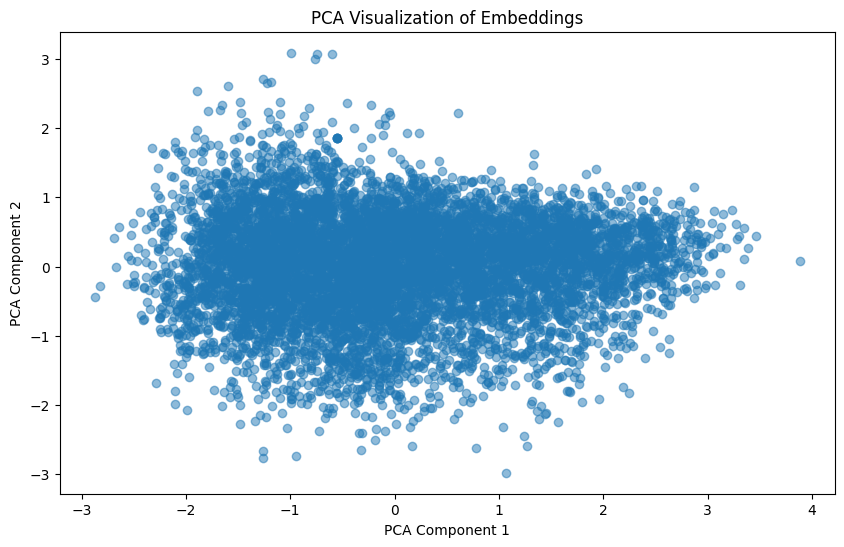

In [5]:
# For PCA visualization
plt.figure(figsize=(10, 6))
plt.scatter(reduced_embeddings_pca[:, 0], reduced_embeddings_pca[:, 1], alpha=0.5)
plt.title('PCA Visualization of Embeddings')
plt.xlabel('PCA Component 1')
plt.ylabel('PCA Component 2')
plt.show()


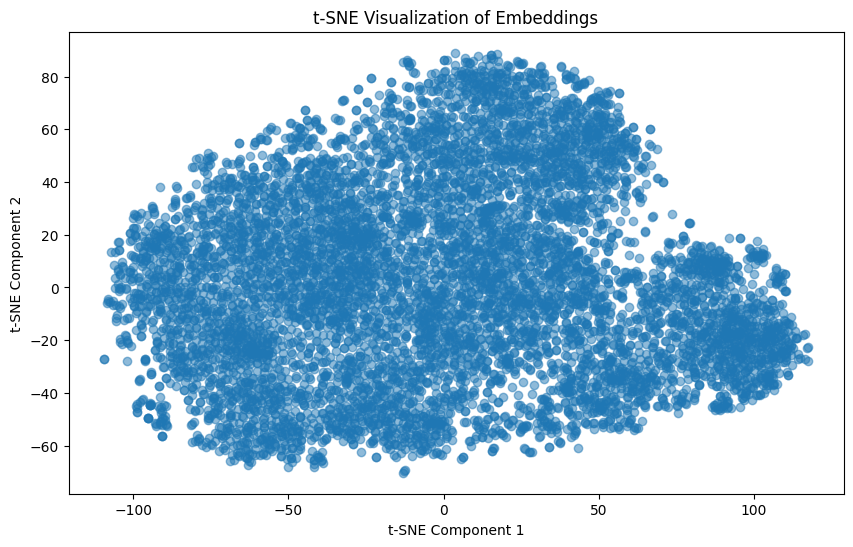

In [6]:
# For t-SNE visualization
plt.figure(figsize=(10, 6))
plt.scatter(reduced_embeddings_tsne[:, 0], reduced_embeddings_tsne[:, 1], alpha=0.5)
plt.title('t-SNE Visualization of Embeddings')
plt.xlabel('t-SNE Component 1')
plt.ylabel('t-SNE Component 2')
plt.show()

In [41]:
df[df['pmcid']=='PMC3068961']['abstract'].item()

'BACKGROUND: Swine origin influenza A/H1N1 infection (H1N1) emerged in early 2009 and rapidly spread to humans. For most infected individuals, symptoms were mild and self-limited; however, a small number developed a more severe clinical syndrome characterized by profound respiratory failure with hospital mortality ranging from 10 to 30%. While supportive care and neuraminidase inhibitors are the main treatment for influenza, data from observational and interventional studies suggest that the course of influenza can be favorably influenced by agents not classically considered as influenza treatments. Multiple observational studies have suggested that HMGCoA reductase inhibitors (statins) can exert a class effect in attenuating inflammation. The Collaborative H1N1 Adjuvant Treatment (CHAT) Pilot Trial sought to investigate the feasibility of conducting a trial during a global pandemic in critically ill patients with H1N1 with the goal of informing the design of a larger trial powered to 

In [53]:
res = model(df[df['pmcid']=='PMC3068961']['abstract'].item(), return_tensor = True)

In [54]:
type(res)
# len(res)
a = [tensor.numpy() for tensor in res]

AttributeError: 'list' object has no attribute 'numpy'

#### Actual

In [6]:
for index, row in df.iterrows():
    print(row['pmcid'],'\t',len(row['abstract']))
    try:
        model(row['abstract'])
    except RuntimeError:
        failed_ids.append(row['pmcid'])

print("===============================================\nFAILED IDs:\n",failed_ids)

PMC137267 	 765
PMC137274 	 567
PMC1475929 	 1311
PMC1481583 	 2317
PMC1525174 	 1706
PMC1540438 	 794
PMC1751007 	 1974
PMC1764036 	 2010
PMC2206432 	 1602
PMC2206439 	 783
PMC2566873 	 1349
PMC2569416 	 1717
PMC2652430 	 1945
PMC2707627 	 2180
PMC2717427 	 1252
PMC2758170 	 1984
PMC2778081 	 1481
PMC2811908 	 951
PMC2820229 	 1164
PMC2825274 	 2107
PMC2846346 	 1588
PMC2851514 	 955
PMC2892358 	 1443
PMC2909231 	 1127
PMC2921955 	 1237
PMC2923618 	 2297
PMC2939531 	 1611
PMC2949385 	 1715
PMC2950129 	 222
PMC2954148 	 1740
PMC2970549 	 2601
PMC2970802 	 671
PMC2990691 	 2276
PMC3001050 	 1084
PMC3002947 	 1345
PMC3003998 	 1070
PMC3010100 	 1022
PMC3022902 	 1864
PMC3030543 	 1598
PMC3037927 	 1865
PMC3042955 	 1290
PMC3060167 	 1812
PMC3060978 	 1773
PMC3061093 	 1552
PMC3064590 	 1803
PMC3065411 	 1491
PMC3065884 	 985
PMC3068961 	 2703
PMC3070035 	 1935
PMC3095640 	 2032
PMC3104979 	 2246
PMC3132365 	 1008
PMC3137391 	 1260
PMC3145309 	 1553
PMC3159992 	 1357
PMC3161824 	 1895
PMC

KeyboardInterrupt: 

In [6]:
for index, row in df.iterrows():
    print(row['pmcid'],'\t',len(row['abstract']))
    try:
        abstract_embeddings.append(model(row['abstract']))
    except RuntimeError:
        failed_ids.append(row['pmcid'])

with open('abstract_embedding','wb') as f:
    pickle.dump(abstract_embeddings,f)

PMC137267 	 765
PMC137274 	 567
PMC1475929 	 1311
PMC1481583 	 2317
PMC1525174 	 1706
PMC1540438 	 794
PMC1751007 	 1974
PMC1764036 	 2010
PMC2206432 	 1602
PMC2206439 	 783
PMC2566873 	 1349
PMC2569416 	 1717
PMC2652430 	 1945
PMC2707627 	 2180
PMC2717427 	 1252
PMC2758170 	 1984
PMC2778081 	 1481
PMC2811908 	 951
PMC2820229 	 1164
PMC2825274 	 2107
PMC2846346 	 1588
PMC2851514 	 955
PMC2892358 	 1443
PMC2909231 	 1127
PMC2921955 	 1237
PMC2923618 	 2297
PMC2939531 	 1611
PMC2949385 	 1715
PMC2950129 	 222
PMC2954148 	 1740
PMC2970549 	 2601
PMC2970802 	 671
PMC2990691 	 2276
PMC3001050 	 1084
PMC3002947 	 1345
PMC3003998 	 1070
PMC3010100 	 1022
PMC3022902 	 1864
PMC3030543 	 1598
PMC3037927 	 1865
PMC3042955 	 1290
PMC3060167 	 1812
PMC3060978 	 1773
PMC3061093 	 1552
PMC3064590 	 1803
PMC3065411 	 1491
PMC3065884 	 985
PMC3068961 	 2703
PMC3070035 	 1935
PMC3095640 	 2032
PMC3104979 	 2246
PMC3132365 	 1008
PMC3137391 	 1260
PMC3145309 	 1553
PMC3159992 	 1357
PMC3161824 	 1895
PMC

KeyboardInterrupt: 

In [7]:
with open('abstract_embedding','wb') as f:
    pickle.dump(abstract_embeddings,f)

In [33]:
# embedding = model(df[df['pmcid']=='PMC3068961']['abstract'].item())
tokens = tokenizer.encode(df[df['pmcid']=='PMC3068961']['abstract'].item())
embedding = model(**tokens)
len(embedding)

TypeError: BertModel(
  (embeddings): BertEmbeddings(
    (word_embeddings): Embedding(30522, 1024, padding_idx=0)
    (position_embeddings): Embedding(512, 1024)
    (token_type_embeddings): Embedding(2, 1024)
    (LayerNorm): LayerNorm((1024,), eps=1e-12, elementwise_affine=True)
    (dropout): Dropout(p=0.1, inplace=False)
  )
  (encoder): BertEncoder(
    (layer): ModuleList(
      (0-23): 24 x BertLayer(
        (attention): BertAttention(
          (self): BertSelfAttention(
            (query): Linear(in_features=1024, out_features=1024, bias=True)
            (key): Linear(in_features=1024, out_features=1024, bias=True)
            (value): Linear(in_features=1024, out_features=1024, bias=True)
            (dropout): Dropout(p=0.1, inplace=False)
          )
          (output): BertSelfOutput(
            (dense): Linear(in_features=1024, out_features=1024, bias=True)
            (LayerNorm): LayerNorm((1024,), eps=1e-12, elementwise_affine=True)
            (dropout): Dropout(p=0.1, inplace=False)
          )
        )
        (intermediate): BertIntermediate(
          (dense): Linear(in_features=1024, out_features=4096, bias=True)
          (intermediate_act_fn): GELUActivation()
        )
        (output): BertOutput(
          (dense): Linear(in_features=4096, out_features=1024, bias=True)
          (LayerNorm): LayerNorm((1024,), eps=1e-12, elementwise_affine=True)
          (dropout): Dropout(p=0.1, inplace=False)
        )
      )
    )
  )
  (pooler): BertPooler(
    (dense): Linear(in_features=1024, out_features=1024, bias=True)
    (activation): Tanh()
  )
) argument after ** must be a mapping, not list

In [32]:
embedding

{'input_ids': [2, 2645, 29, 13295, 4235, 7010, 42, 18, 17060, 2527, 11, 17060, 12, 8145, 1682, 2743, 7187, 1690, 5323, 6378, 1701, 5096, 17, 1725, 2261, 4017, 3415, 15, 3037, 1748, 4825, 1690, 3224, 16, 3750, 30, 2250, 15, 42, 2718, 2534, 2829, 42, 2051, 3258, 2121, 3328, 3570, 1772, 9640, 4264, 3624, 1715, 2895, 3144, 6260, 1814, 2073, 1701, 2618, 8, 17, 2555, 11844, 2434, 1690, 22054, 4299, 1810, 1680, 2504, 2015, 1725, 7010, 15, 2123, 1814, 8137, 1690, 12663, 2223, 2393, 1760, 1680, 4216, 1685, 7010, 1883, 1765, 19693, 6013, 1772, 3914, 1888, 24242, 3345, 1732, 7010, 4438, 17, 3028, 8137, 2223, 1953, 3758, 1760, 12447, 6826, 1012, 8652, 4299, 11, 13927, 12, 1883, 10225, 42, 2726, 2224, 1682, 22831, 4287, 17, 1680, 13124, 17060, 7272, 2015, 11, 22091, 12, 8757, 4033, 7697, 1701, 3357, 1680, 7651, 1685, 12617, 42, 4033, 2098, 42, 4908, 16422, 1682, 8837, 3542, 1808, 1715, 17060, 1715, 1680, 6202, 1685, 28418, 1680, 2693, 1685, 42, 4595, 4033, 21236, 1701, 2958, 3409, 1685, 13927, 1755

In [28]:
tokenizer.tokenize(df[df['pmcid']=='PMC3068961']['abstract'].item())

['background',
 ':',
 'swine',
 'origin',
 'influenza',
 'a',
 '/',
 'h1n1',
 'infection',
 '(',
 'h1n1',
 ')',
 'emerged',
 'in',
 'early',
 '2009',
 'and',
 'rapidly',
 'spread',
 'to',
 'humans',
 '.',
 'for',
 'most',
 'infected',
 'individuals',
 ',',
 'symptoms',
 'were',
 'mild',
 'and',
 'self',
 '-',
 'limited',
 ';',
 'however',
 ',',
 'a',
 'small',
 'number',
 'developed',
 'a',
 'more',
 'severe',
 'clinical',
 'syndrome',
 'characterized',
 'by',
 'profound',
 'respiratory',
 'failure',
 'with',
 'hospital',
 'mortality',
 'ranging',
 'from',
 '10',
 'to',
 '30',
 '%',
 '.',
 'while',
 'supportive',
 'care',
 'and',
 'neuraminidase',
 'inhibitors',
 'are',
 'the',
 'main',
 'treatment',
 'for',
 'influenza',
 ',',
 'data',
 'from',
 'observational',
 'and',
 'interventional',
 'studies',
 'suggest',
 'that',
 'the',
 'course',
 'of',
 'influenza',
 'can',
 'be',
 'favorably',
 'influenced',
 'by',
 'agents',
 'not',
 'classically',
 'considered',
 'as',
 'influenza',
 'tr

In [25]:
embedding[0][0]

[0.5142417550086975,
 0.08155256509780884,
 0.034163281321525574,
 -0.8279801607131958,
 0.3322891592979431,
 -0.21080899238586426,
 0.14807438850402832,
 0.2521994709968567,
 -0.24770431220531464,
 -0.7487756609916687,
 -0.013647946529090405,
 -0.10535120218992233,
 -0.10058475285768509,
 0.9482496976852417,
 -1.5779939889907837,
 1.109161138534546,
 -0.24987438321113586,
 -0.4483624994754791,
 -0.06176101788878441,
 0.08904893696308136,
 -1.2488869428634644,
 0.7807446122169495,
 1.0908424854278564,
 0.5648869872093201,
 0.013894198462367058,
 0.32507944107055664,
 -1.146822452545166,
 0.37778666615486145,
 0.4523172974586487,
 1.059597134590149,
 -0.28813809156417847,
 0.2323313057422638,
 -1.0417789220809937,
 0.4067012667655945,
 -0.8778479099273682,
 -1.0887054204940796,
 -1.619092345237732,
 0.9968230724334717,
 0.6093519330024719,
 1.528777837753296,
 0.04354257881641388,
 -1.1230148077011108,
 -0.08199885487556458,
 1.380594253540039,
 0.0011023988481611013,
 0.793138802051544

In [16]:
text = df[df['pmcid']=='PMC2970549']['abstract'].item()
# len(text)
text

"BACKGROUND: Neuraminidase inhibitors are thought to be efficacious in reducing the time to alleviation of symptoms in outpatients with seasonal influenza. The objective of this study was to compare the short-term virological efficacy of oseltamivir-zanamivir combination versus each monotherapy plus placebo. METHODS AND FINDINGS: We conducted a randomized placebo-controlled trial with 145 general practitioners throughout France during the 2008–2009 seasonal influenza epidemic. Patients, general practitioners, and outcome assessors were all blinded to treatment assignment. Adult outpatients presenting influenza-like illness for less than 36 hours and a positive influenza A rapid test diagnosis were randomized to oseltamivir 75 mg orally twice daily plus zanamivir 10 mg by inhalation twice daily (OZ), oseltamivir plus inhaled placebo (O), or zanamivir plus oral placebo (Z). Treatment efficacy was assessed virologically according to the proportion of patients with nasal influenza reverse 

In [18]:
text = df[df['pmcid']=='PMC3068961']['abstract'].item()
# len(text)
text

'BACKGROUND: Swine origin influenza A/H1N1 infection (H1N1) emerged in early 2009 and rapidly spread to humans. For most infected individuals, symptoms were mild and self-limited; however, a small number developed a more severe clinical syndrome characterized by profound respiratory failure with hospital mortality ranging from 10 to 30%. While supportive care and neuraminidase inhibitors are the main treatment for influenza, data from observational and interventional studies suggest that the course of influenza can be favorably influenced by agents not classically considered as influenza treatments. Multiple observational studies have suggested that HMGCoA reductase inhibitors (statins) can exert a class effect in attenuating inflammation. The Collaborative H1N1 Adjuvant Treatment (CHAT) Pilot Trial sought to investigate the feasibility of conducting a trial during a global pandemic in critically ill patients with H1N1 with the goal of informing the design of a larger trial powered to 

In [45]:
# Tokenize the input text
tokens = tokenizer(df[df['pmcid']=='PMC2970549']['abstract'].item(), return_tensors="pt", padding=True, truncation=True, max_length=3000, add_special_tokens=True)

# Forward pass through the model to get embeddings
with torch.no_grad():
    outputs = model(**tokens)

# Extract the embeddings (output of the model)
embeddings = outputs.last_hidden_state  # Assuming you want the embeddings from the last layer

# You can now use 'embeddings' for downstream tasks or analysis
print(embeddings)

RuntimeError: The size of tensor a (677) must match the size of tensor b (512) at non-singleton dimension 1

In [35]:
model(df[df['pmcid']=='PMC3068961']['abstract'].item())

[[[0.5142417550086975,
   0.08155256509780884,
   0.034163281321525574,
   -0.8279801607131958,
   0.3322891592979431,
   -0.21080899238586426,
   0.14807438850402832,
   0.2521994709968567,
   -0.24770431220531464,
   -0.7487756609916687,
   -0.013647946529090405,
   -0.10535120218992233,
   -0.10058475285768509,
   0.9482496976852417,
   -1.5779939889907837,
   1.109161138534546,
   -0.24987438321113586,
   -0.4483624994754791,
   -0.06176101788878441,
   0.08904893696308136,
   -1.2488869428634644,
   0.7807446122169495,
   1.0908424854278564,
   0.5648869872093201,
   0.013894198462367058,
   0.32507944107055664,
   -1.146822452545166,
   0.37778666615486145,
   0.4523172974586487,
   1.059597134590149,
   -0.28813809156417847,
   0.2323313057422638,
   -1.0417789220809937,
   0.4067012667655945,
   -0.8778479099273682,
   -1.0887054204940796,
   -1.619092345237732,
   0.9968230724334717,
   0.6093519330024719,
   1.528777837753296,
   0.04354257881641388,
   -1.1230148077011108,
 

In [8]:
df['embedding'] = [model(abstract) for abstract in df['abstract']]

RuntimeError: The size of tensor a (677) must match the size of tensor b (512) at non-singleton dimension 1

In [16]:
model(df['abstract'][0])

[[[0.40049391984939575,
   0.030143925920128822,
   0.02105000987648964,
   -0.7096412777900696,
   0.34773239493370056,
   0.15312498807907104,
   0.2177794873714447,
   0.10653875023126602,
   -0.3418835401535034,
   -0.728869616985321,
   0.35964298248291016,
   -0.22408083081245422,
   -0.6497882008552551,
   0.850989818572998,
   -1.4645694494247437,
   1.0039585828781128,
   -0.2913367748260498,
   -0.4487176537513733,
   0.12275230884552002,
   0.5325503945350647,
   -1.3292515277862549,
   1.15142023563385,
   1.0438358783721924,
   0.5680478811264038,
   -0.25428783893585205,
   0.08431439846754074,
   -0.7923162579536438,
   0.7541940808296204,
   0.541073739528656,
   0.9871214628219604,
   -0.16181136667728424,
   0.41654226183891296,
   -1.0185052156448364,
   0.19113542139530182,
   -0.383390873670578,
   -1.2798346281051636,
   -1.3708796501159668,
   1.0645205974578857,
   0.4391646981239319,
   1.780303716659546,
   0.14906074106693268,
   -1.0984786748886108,
   -0.29

In [14]:
from sklearn.manifold import TSNE

In [15]:
# Instantialte tsne, specify cosine metric
tsne = TSNE(random_state = 0, n_iter = 1000, metric = 'cosine')

In [18]:
# Fit and transform
embeddings2d = tsne.fit_transform(df['abstract'])

ValueError: could not convert string to float: 'Recent evidence suggests that critically ill patients are able to tolerate lower levels of haemoglobin than was previously believed. It is our goal to show that transfusing to a level of 100 g/l does not improve mortality and other clinically important outcomes in a critical care setting. Although many questions remain, many laboratory and clinical studies, including a recent randomized controlled trial (RCT), have established that transfusing to normal haemoglobin concentrations does not improve organ failure and mortality in the critically ill patient. In addition, a restrictive transfusion strategy will reduce exposure to allogeneic transfusions, result in more efficient use of red blood cells (RBCs), save blood overall, and decrease health care costs.'

In [4]:
paragraph = '''Jupiter is the fifth planet from the Sun and the largest in the Solar System. 
    It is a gas giant with a mass one-thousandth that of the Sun, 
    but two-and-a-half times that of all the other planets in the Solar System combined. 
    Jupiter is one of the brightest objects visible to the naked eye in the night sky, 
    and has been known to ancient civilizations since before recorded history. 
    It is named after the Roman god Jupiter. When viewed from Earth, 
    Jupiter can be bright enough for its reflected light to cast shadows, 
    and is on average the third-brightest natural object in the night sky after the Moon and Venus.'''

In [5]:
import nltk
# tokeninizing the paragraph
sent_text = nltk.sent_tokenize(paragraph)
word_text = [nltk.word_tokenize(sent) for sent in sent_text]
print(word_text)

[['Jupiter', 'is', 'the', 'fifth', 'planet', 'from', 'the', 'Sun', 'and', 'the', 'largest', 'in', 'the', 'Solar', 'System', '.'], ['It', 'is', 'a', 'gas', 'giant', 'with', 'a', 'mass', 'one-thousandth', 'that', 'of', 'the', 'Sun', ',', 'but', 'two-and-a-half', 'times', 'that', 'of', 'all', 'the', 'other', 'planets', 'in', 'the', 'Solar', 'System', 'combined', '.'], ['Jupiter', 'is', 'one', 'of', 'the', 'brightest', 'objects', 'visible', 'to', 'the', 'naked', 'eye', 'in', 'the', 'night', 'sky', ',', 'and', 'has', 'been', 'known', 'to', 'ancient', 'civilizations', 'since', 'before', 'recorded', 'history', '.'], ['It', 'is', 'named', 'after', 'the', 'Roman', 'god', 'Jupiter', '.'], ['When', 'viewed', 'from', 'Earth', ',', 'Jupiter', 'can', 'be', 'bright', 'enough', 'for', 'its', 'reflected', 'light', 'to', 'cast', 'shadows', ',', 'and', 'is', 'on', 'average', 'the', 'third-brightest', 'natural', 'object', 'in', 'the', 'night', 'sky', 'after', 'the', 'Moon', 'and', 'Venus', '.']]


In [6]:
from gensim.models import Word2Vec
# train model to get the embeddings
model = Word2Vec(word_text, min_count=1)

In [ ]:
# getting the embedding vectors
X = model[model.wv.vocab]
# dimentionality reduction using PCA
pca = PCA(n_components=2)
# running the transformations
result = pca.fit_transform(X)
# getting the corresponding words
words = list(model.wv.vocab)